<a href="https://colab.research.google.com/github/amitsoni24/Pawnless-Chess-Endgame-Optimization/blob/main/Pawnless_Chess_Endgame_Optimization.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

<center><h1>Optimization in Pawnless Chess Endgame Analysis</h1> </center>

## Background and Motivation

Chess endgames, particularly pawnless scenarios, present a unique challenge that straddles the boundaries of art and computational science. These endgames simplify the vast complexity of a full chess game while maintaining a depth that demands precise tactical and strategic play. This combination makes them ideal for deep analytical approaches using computational optimization methods.

In games without pawns, where typical strategies like pawn promotion are off the table, the focus shifts entirely to the tactical precision and effectiveness of the remaining pieces. These scenarios often hinge on strategic concepts like opposition, king safety, and Zugzwang—a situation where a player is put at a disadvantage because they must make a move when they would prefer to pass and not to move.


<center><img src="https://firebasestorage.googleapis.com/v0/b/portfolio-004-0024.appspot.com/o/cmse%20802%2FScreenshot%202024-11-10%20at%2021.20.48.png?alt=media&token=8fa80791-66d2-4479-bddc-4ed6868a469a" width="300" height="100"></center>


### Project Objectives:

I aim to analyze and optimize decision-making in simplified pawnless chess endgame scenarios using computational optimization techniques. By focusing on positions with only kings and a few additional pieces (e.g., King and Rook vs. King), I will:

1. Develop a computational model for pawnless chess endgames.
2. Implement optimization algorithms to identify optimal moves.
3. Test and compare the performance and convergence properties of these algorithms in solving key endgame problems.

The project emphasizes computational efficiency and practical application of optimization techniques to determine the best moves in critical pawnless endgame situations, incorporating strategic concepts like opposition and Zugzwang.

### Assumptions for Pawnless Endgames and Complexity Reduction:

1. **Pawnless Endgames with Standard Rules:** I will focus on well-defined pawnless endgames, such as King and Rook vs. King or King and Two Bishops vs. King, while adhering to official chess rules, including checkmate, stalemate, and draw conditions.

2. **No Pawn Promotion at the Start:** I assume no pawn promotion has occurred before the start of the endgame to simplify the analysis.

3. **Finite Horizon and Symmetry Exploitation:** I will evaluate moves up to a fixed depth to limit search tree branching, and symmetrical board positions will be treated as identical to reduce redundant computations.

4. **Simplified Evaluation Function:** The evaluation function will emphasize material value, king safety, opposition, and Zugzwang for streamlined decision-making.

5. **Predefined Test Cases:** I will use specific, well-known test positions like  Lucena and Philidor positions for King and Rook vs. King with theoretically optimal solutions to benchmark the algorithms.

6. **Focus on Common Scenarios and Ideal Play:** I will concentrate on typical endgame scenarios, excluding rare cases like underpromotions, and assume ideal play without time constraints for clarity and computational feasibility.


## Methodology

### Setting Up the Environment

- python-chess: This is a powerful library for chess functionalities in Python. It supports move generation, move validation, and board setup, among other features.

`pip install python-chess numpy matplotlib pandas stockfish`


In [ ]:
import chess
import random
import chess.syzygy
import chess.svg
from graphviz import Digraph
from IPython.display import display, SVG
from stockfish import Stockfish

#### Set up Stockfish

In [ ]:
stockfish = Stockfish('/opt/homebrew/bin/stockfish')  # Update this path as necessary
stockfish

### Endgame Modeling

#### Define Board States

I will set up the board for three famous pawnless endgames using the python-chess library. Here are three well-known scenarios:
- **King and Rook vs. King (KR vs. K):** This endgame demonstrates basic principles of forcing checkmate with a rook and king against a lone king.
- **King and Two Bishops vs. King (KBB vs. K):** This endgame is about coordinating two bishops and a king to force checkmate, showcasing the power of bishop pair coordination.
- **King and Knight vs. King (KN vs. K):** Although typically a theoretical draw, this scenario is important for understanding how to maneuver and position pieces in constrained settings.

In [ ]:
#Function to set up a specific endgame
endgame_setups = {
        "KR vs K": {
            chess.E1: chess.Piece(chess.KING, chess.WHITE),
            chess.H1: chess.Piece(chess.ROOK, chess.WHITE),
            chess.G8: chess.Piece(chess.KING, chess.BLACK)
        },
        "KBB vs K": {
            chess.E1: chess.Piece(chess.KING, chess.WHITE),
            chess.D2: chess.Piece(chess.BISHOP, chess.WHITE),
            chess.G2: chess.Piece(chess.BISHOP, chess.WHITE),
            chess.G8: chess.Piece(chess.KING, chess.BLACK)
        },
        "KN vs K": {
            chess.E1: chess.Piece(chess.KING, chess.WHITE),
            chess.D2: chess.Piece(chess.KNIGHT, chess.WHITE),
            chess.H8: chess.Piece(chess.KING, chess.BLACK)
        },
        "KN vs K Checkmate": {
            chess.B6: chess.Piece(chess.KING, chess.WHITE),
            chess.G1: chess.Piece(chess.ROOK, chess.WHITE),
            chess.A8: chess.Piece(chess.KING, chess.BLACK)
        },
        "KRBB vs KBN": {
            chess.B2: chess.Piece(chess.KING, chess.WHITE),
            chess.B5: chess.Piece(chess.ROOK, chess.WHITE),
            chess.E6: chess.Piece(chess.BISHOP, chess.WHITE),
            chess.F6: chess.Piece(chess.BISHOP, chess.WHITE),
            chess.E8: chess.Piece(chess.KING, chess.BLACK),
            chess.B7: chess.Piece(chess.BISHOP, chess.BLACK),
            chess.F3: chess.Piece(chess.KNIGHT, chess.BLACK)
        },
        "KQ vs KR": {
            chess.E1: chess.Piece(chess.KING, chess.WHITE),
            chess.D1: chess.Piece(chess.QUEEN, chess.WHITE),
            chess.H8: chess.Piece(chess.KING, chess.BLACK),
            chess.G8: chess.Piece(chess.ROOK, chess.BLACK)
        },
        "KR vs KN": {
            chess.E1: chess.Piece(chess.KING, chess.WHITE),
            chess.H1: chess.Piece(chess.ROOK, chess.WHITE),
            chess.G8: chess.Piece(chess.KING, chess.BLACK),
            chess.F8: chess.Piece(chess.KNIGHT, chess.BLACK)
        },
        "KQ vs KQ": {
            chess.E1: chess.Piece(chess.KING, chess.WHITE),
            chess.D1: chess.Piece(chess.QUEEN, chess.WHITE),
            chess.H8: chess.Piece(chess.KING, chess.BLACK),
            chess.G8: chess.Piece(chess.QUEEN, chess.BLACK)
        },
        "KBB vs KNN": {
            chess.E1: chess.Piece(chess.KING, chess.WHITE),
            chess.D2: chess.Piece(chess.BISHOP, chess.WHITE),
            chess.G2: chess.Piece(chess.BISHOP, chess.WHITE),
            chess.G8: chess.Piece(chess.KING, chess.BLACK),
            chess.F8: chess.Piece(chess.KNIGHT, chess.BLACK),
            chess.H7: chess.Piece(chess.KNIGHT, chess.BLACK)
        },
        "KRN vs KBN": {
            chess.E1: chess.Piece(chess.KING, chess.WHITE),
            chess.H1: chess.Piece(chess.ROOK, chess.WHITE),
            chess.G2: chess.Piece(chess.KNIGHT, chess.WHITE),
            chess.G8: chess.Piece(chess.KING, chess.BLACK),
            chess.F8: chess.Piece(chess.BISHOP, chess.BLACK),
            chess.H7: chess.Piece(chess.KNIGHT, chess.BLACK)
        },
        "KQ vs KBN": {
            chess.E1: chess.Piece(chess.KING, chess.WHITE),
            chess.D1: chess.Piece(chess.QUEEN, chess.WHITE),
            chess.H8: chess.Piece(chess.KING, chess.BLACK),
            chess.G8: chess.Piece(chess.BISHOP, chess.BLACK),
            chess.F8: chess.Piece(chess.KNIGHT, chess.BLACK)
        },
        "KQ vs KB": {
            chess.E1: chess.Piece(chess.KING, chess.WHITE),
            chess.D1: chess.Piece(chess.QUEEN, chess.WHITE),
            chess.H8: chess.Piece(chess.KING, chess.BLACK),
            chess.G8: chess.Piece(chess.BISHOP, chess.BLACK)
        },
        "KN vs KR": {
            chess.E1: chess.Piece(chess.KING, chess.WHITE),
            chess.D2: chess.Piece(chess.KNIGHT, chess.WHITE),
            chess.H8: chess.Piece(chess.KING, chess.BLACK),
            chess.G8: chess.Piece(chess.ROOK, chess.BLACK)
        },
        "KBB vs KB": {
            chess.E1: chess.Piece(chess.KING, chess.WHITE),
            chess.D2: chess.Piece(chess.BISHOP, chess.WHITE),
            chess.G2: chess.Piece(chess.BISHOP, chess.WHITE),
            chess.H8: chess.Piece(chess.KING, chess.BLACK),
            chess.G8: chess.Piece(chess.BISHOP, chess.BLACK)
        },
        "Gukesh vs Richard": {
            chess.A7: chess.Piece(chess.BISHOP, chess.WHITE),
            chess.A6: chess.Piece(chess.BISHOP, chess.BLACK),
            chess.D5: chess.Piece(chess.KING, chess.BLACK),
            chess.F4: chess.Piece(chess.KING, chess.WHITE)
        }
    }
boards = endgame_setups.keys()

def setup_endgame(position):
    board = chess.Board(None)  # Start with an empty board

    # Set the pieces on the board according to the selected endgame scenario
    setup = endgame_setups.get(position, {})
    for square, piece in setup.items():
        board.set_piece_at(square, piece)

    return board




In [ ]:
boards = list(boards)

##### King and Rook vs. King

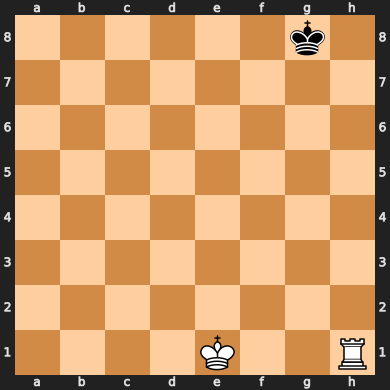

In [ ]:
kr_vs_k = setup_endgame("KR vs K")
kr_vs_k

##### King and Two Bishops vs. King

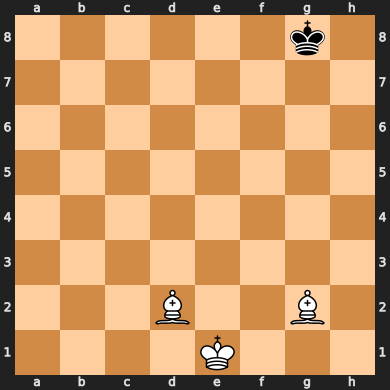

In [ ]:
kbb_vs_k = setup_endgame("KBB vs K")
kbb_vs_k

##### King and Knight vs. King:

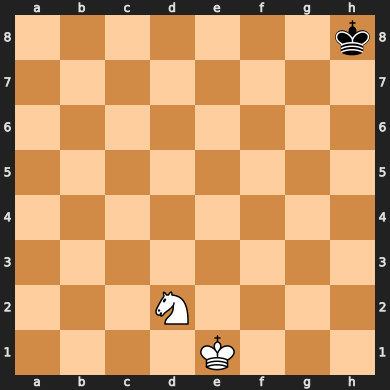

In [ ]:
kn_vs_k = setup_endgame("KN vs K")
kn_vs_k

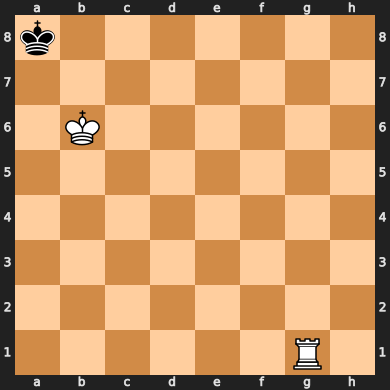

In [ ]:
kn_vs_k_checkmate = setup_endgame("KN vs K Checkmate")
kn_vs_k_checkmate

In [ ]:
for i in range(len(boards)):
    board = setup_endgame(boards[i])
    print(f"Board {boards[i]},{board.is_valid()}")


Board KR vs K,True
Board KBB vs K,True
Board KN vs K,True
Board KN vs K Checkmate,True
Board KRBB vs KBN,True
Board KQ vs KR,True
Board KR vs KN,True
Board KQ vs KQ,True
Board KBB vs KNN,True
Board KRN vs KBN,True
Board KQ vs KBN,True
Board KQ vs KB,True
Board KN vs KR,True
Board KBB vs KB,True
Board Gukesh vs Richard,True


#### Encode Positions

In [ ]:
def encode_position(board):
    piece_to_value = {
        None: 0,  # empty square
        'K': 1,   # White King
        'k': 2,   # Black King
        'R': 3,   # White Rook
        'B': 4,   # White Bishop
        'N': 5    # White Knight
    }

    # Create a list to represent the board as a vector
    board_vector = []

    # Iterate over all squares on the chess board
    for square in chess.SQUARES:
        piece = board.piece_at(square)
        if piece:
            # Convert piece to a simple integer value
            piece_value = piece_to_value[piece.symbol()]
        else:
            piece_value = piece_to_value[None]
        board_vector.append(piece_value)

    return board_vector

# Encoding the board states
encoded_kr_vs_k = encode_position(kr_vs_k)
encoded_kbb_vs_k = encode_position(kbb_vs_k)
encoded_kn_vs_k = encode_position(kn_vs_k)

# Show the encoded boards
print("Encoded KR vs K:", encoded_kr_vs_k)
print("Encoded KBB vs K:", encoded_kbb_vs_k)
print("Encoded KN vs K:", encoded_kn_vs_k)


Encoded KR vs K: [0, 0, 0, 0, 1, 0, 0, 3, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 0]
Encoded KBB vs K: [0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 4, 0, 0, 4, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 0]
Encoded KN vs K: [0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 5, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2]


### Designing the Objective Function

The Objective function $f(x)$ should comprehensively consider various aspects of the game state that influence the outcome.

**Components of the Objective Function:**

1. **Material Value**
2. **King Safety and Opposition**
3. **Zugzwang Detection**
4. **Terminal States**

**Weighted Scoring:**
To combine these elements into a single score, you can use weighted coefficients for each component, reflecting their relative importance:

$$f(x) = w_1 \cdot g(x) + w_2 \cdot k(x) + w_3 \cdot z(x) + \text{Terminal State Bonus}$$

Where $w_1, w_2,$ and $w_3$ are the weights for each component.


#### Material Value

Material value calculation is a fundamental concept in chess evaluation. It assesses the worth of the pieces on the board based on their relative strength and utility in the game. Each piece is assigned a standard value:

- **King:** Not assigned a numeric value since it's irreplaceable.
- **Rook:** High value (e.g., 5 points) due to its range and control.
- **Bishop:** Moderate value (e.g., 3 points) for long-range control.
- **Knight:** Moderate value (e.g., 3 points) for its unique movement pattern.
- **Queen:** High value (e.g., 8 points) due to its range and control.
  
The material value is computed by summing the values of all pieces for one player and subtracting the total value of the opponent’s pieces. In pawnless endgames, this calculation helps quantify the advantage of having more or stronger pieces.

In [ ]:
def calculate_material_value(board):
    material_score = 0
    piece_values = {
        chess.ROOK: 5,
        chess.BISHOP: 3,
        chess.KNIGHT: 3,
        chess.QUEEN: 8
    }

    for square in chess.SQUARES:
        piece = board.piece_at(square)
        if piece and piece.color == chess.WHITE:
            material_score += piece_values.get(piece.piece_type, 0)
        elif piece and piece.color == chess.BLACK:
            material_score -= piece_values.get(piece.piece_type, 0)

    return material_score


#### King Safety and Opposition
In chess, **King Safety** involves positioning the king where it's protected and can contribute offensively, especially important in endgames where a central, active king can control key squares and avoid threats. **Opposition** occurs when two kings stand on the same file, rank, or diagonal with one square apart, limiting the opponent's king's mobility and controlling territory, crucial in both pawn and pawnless endgames.

**Analyzing these concepts** helps in:

1. **Strategic Control**: Ensuring king safety and maintaining opposition controls the game flow by protecting one’s king and restricting the opponent's.
2. **Endgame Advantage**: Proper use of these tactics often determines endgame outcomes by enabling winning strategies or securing draws from less favorable positions.
3. **Evaluation and Planning**: These analyses are integral to chess algorithms for deep position assessment and strategic planning, enhancing performance in endgame scenarios.

Understanding and utilizing these concepts are key for strategic king positioning in endgames, vital for both human players and computational engines.

In [ ]:
def king_safety_and_opposition(board):
    safety_score = 0
    white_king_position = board.king(chess.WHITE)
    black_king_position = board.king(chess.BLACK)

    # Ensure both kings are on the board before proceeding
    if white_king_position is None or black_king_position is None:
        return 0  # Return a neutral safety score if a king is missing

    # Calculate the distance between kings to evaluate opposition
    wk_file, wk_rank = chess.square_file(white_king_position), chess.square_rank(white_king_position)
    bk_file, bk_rank = chess.square_file(black_king_position), chess.square_rank(black_king_position)

    # Check if the kings are in opposition
    file_distance = abs(wk_file - bk_file)
    rank_distance = abs(wk_rank - bk_rank)
    if file_distance == 1 and rank_distance == 0 or file_distance == 0 and rank_distance == 1:
        safety_score += 1  # Direct opposition, score positively

    # Centralization bonus for kings
    if 2 <= wk_file <= 5 and 2 <= wk_rank <= 5:
        safety_score += 0.5  # White king is well-centralized
    if 2 <= bk_file <= 5 and 2 <= bk_rank <= 5:
        safety_score -= 0.5  # Black king is well-centralized, negatively scored for white

    return safety_score


#### Zugzwang Detection
Zugzwang, a term from chess, describes a scenario where a player must move but all possible moves deteriorate their position. In computational chess, detecting Zugzwang involves:

1. **Check for Checkmate or Stalemate**: The function returns preset scores if the board is in a checkmate (-100) or stalemate (0) state.
2. **Evaluate Current Mobility**: It counts the number of legal moves available from the current board position, using this count as a basic score (negative to indicate fewer moves are worse).
3. **Simulate Moves**: For each legal move, the function simulates the move on the board, then counts and evaluates the mobility after the move.
4. **Mobility Comparison**: After each simulation, it compares the mobility score to the original. If any move results in improved mobility, it's not zugzwang; otherwise, if all moves reduce mobility, it indicates zugzwang.
5. **Return Scores**: Returns 0 if not zugzwang, and 2 if zugzwang is confirmed, suggesting a strategic disadvantage due to reduced mobility with every possible move.

This zugzwang detection is essential for strategizing in chess, especially in tightly contested endgames where every move's impact is magnified.

In [ ]:
def zugzwang_detection(board):
    if board.is_checkmate():
        return -100  # Negative score for checkmate
    if board.is_stalemate():
        return 0  # Neutral score for stalemate

    # Simply count the number of legal moves as a basic score
    legal_moves_count = len(list(board.legal_moves))
    current_score = -legal_moves_count  # Less mobility might imply a worse position

    for move in board.legal_moves:
        board.push(move)
        # Check the mobility after making a move
        score_after_move = -len(list(board.legal_moves))
        board.pop()

        # Check if the current move leads to a position with worse mobility
        if score_after_move <= current_score:
            current_score = score_after_move
        else:
            # If any move improves the position, it's not zugzwang
            return 0

    # If all moves worsen the position, we confirm it's zugzwang
    return 2  # Arbitrary positive score indicating significant strategic advantage


#### Evaluate Position

In [ ]:
def evaluate_position(board):
    # Weight coefficients
    w_material = 1.0
    w_king_safety = 1.5
    w_zugzwang = 2.0
    w_terminal = 100.0

    material_value = calculate_material_value(board)
    king_safety = king_safety_and_opposition(board)
    zugzwang = zugzwang_detection(board)  # Assuming this function exists
    terminal_state = 0  # Placeholder for terminal state calculation

    # Check terminal states
    if board.is_checkmate():
        terminal_state = w_terminal
    elif board.is_stalemate() or board.is_insufficient_material():
        terminal_state = -w_terminal

    score = (w_material * material_value +
             w_king_safety * king_safety +
             w_zugzwang * zugzwang +
             terminal_state)

    return score


### Implementing Optimization Algorithms
The two main optimization algorithms I am considering for this project are Minimax with Alpha-Beta Pruning and Monte Carlo Tree Search (MCTS). Each offers unique benefits for game decision-making.

#### Minimax with Alpha-Beta Pruning

This algorithm is a depth-first, adversarial search algorithm that considers possible future game states to decide the best move. Alpha-Beta Pruning enhances Minimax by "pruning" branches in the game tree that need not be explored, which significantly reduces the number of nodes evaluated.

In [ ]:
def sanitize_label(text):
    """
    Sanitize text to make it safe for use as a Graphviz label.
    """
    return text.replace('"', "'")

def minimax(board, depth, alpha, beta, maximizing_player, graph, parent_node, move=None):
    # Generate a node label and a unique node name based on the board's hash
    node_label = sanitize_label(str(board)) if move is None else f"{move}: {sanitize_label(str(board))}"
    current_node = f"node{hash(node_label)}"

    # Create the graph node with a truncated label for clarity
    graph.node(current_node, label=node_label[:50])
    if parent_node:  # Only draw an edge if there's a parent node
        graph.edge(parent_node, current_node, label=str(move))

    # Base case: If at max depth or game is over, evaluate the position
    if depth == 0 or board.is_game_over():
        score = evaluate_position(board)
        graph.node(current_node, label=f"{node_label}\nScore: {score}", shape='box')
        return score

    # Recursion for maximizing player
    if maximizing_player:
        max_eval = float('-inf')
        for move in board.legal_moves:
            board.push(move)
            eval = minimax(board, depth - 1, alpha, beta, False, graph, current_node, move)
            board.pop()
            max_eval = max(max_eval, eval)
            alpha = max(alpha, eval)  # Update alpha
            if beta <= alpha:
                break  # Alpha-beta pruning
        return max_eval
    else:
        # Recursion for minimizing player
        min_eval = float('inf')
        for move in board.legal_moves:
            board.push(move)
            eval = minimax(board, depth - 1, alpha, beta, True, graph, current_node, move)
            board.pop()
            min_eval = min(min_eval, eval)
            beta = min(beta, eval)  # Update beta
            if beta <= alpha:
                break  # Alpha-beta pruning
        return min_eval


#### Monte Carlo Tree Search (MCTS)
MCTS uses random sampling of the decision space and builds a search tree according to the results of previous explorations. Thus, it balances between exploring uncharted territory and exploiting known successful paths.

In [ ]:
def mcts(board, depth):
    moves = list(board.legal_moves)  # List all legal moves from the current board state
    best_move = None
    best_score = float('-inf')

    # Explore each move
    for move in moves:
        board.push(move)  # Make the move
        wins = 0
        # Simulate several games using random playouts from the current board state
        for _ in range(1000):  # Number of simulations
            if simulate_random_playout(board):
                wins += 1
        board.pop()  # Undo the move

        # Keep track of the move that leads to the highest number of wins
        if wins > best_score:
            best_score = wins
            best_move = move

    return best_move

def simulate_random_playout(board):
    simulation_board = board.copy()  # Create a copy of the board to simulate play without affecting the original
    move_count = 0  # Track the number of moves played in the simulation
    while not simulation_board.is_game_over():
        move_count += 1
        if move_count >= 10:  # Evaluate the position after a certain number of moves to avoid very long simulations
            return evaluate_position(simulation_board)
        move = random.choice(list(simulation_board.legal_moves))  # Select a random legal move
        simulation_board.push(move)  # Make the move

    # Assess the result of the game
    if simulation_board.result() == "1-0":
        return 100  # Arbitrary high score for a win
    elif simulation_board.result() == "0-1":
        return -100  # Arbitrary low score for a loss
    else:
        return 0  # Neutral score for a draw or stalemate


## Results

### Testing

Testing KR vs K with Minimax:


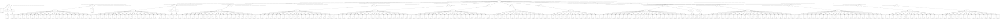

Minimax Result: 9.75
Testing KR vs K with MCTS:
MCTS Result: e1f2
Testing KBB vs K with Minimax:


Minimax Result: 10.75
Testing KBB vs K with MCTS:
MCTS Result: d2a5
Testing KN vs K with Minimax:


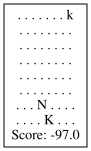

Minimax Result: -97.0
Testing KN vs K with MCTS:
MCTS Result: d2e4
Testing KN vs K Checkmate with Minimax:


Minimax Result: 9.75
Testing KN vs K Checkmate with MCTS:
MCTS Result: g1g8
Testing KRBB vs KBN with Minimax:


Minimax Result: 12.0
Testing KRBB vs KBN with MCTS:
MCTS Result: b5b7
Testing KQ vs KR with Minimax:


Minimax Result: 7.0
Testing KQ vs KR with MCTS:
MCTS Result: d1e2
Testing KR vs KN with Minimax:


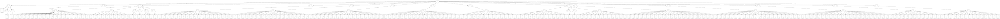

Minimax Result: 6.0
Testing KR vs KN with MCTS:
MCTS Result: e1e2
Testing KQ vs KQ with Minimax:


Minimax Result: 4.0
Testing KQ vs KQ with MCTS:
MCTS Result: d1d8
Testing KBB vs KNN with Minimax:


Minimax Result: 3.0
Testing KBB vs KNN with MCTS:
MCTS Result: d2g5
Testing KRN vs KBN with Minimax:


Minimax Result: 5.0
Testing KRN vs KBN with MCTS:
MCTS Result: h1g1
Testing KQ vs KBN with Minimax:


Minimax Result: 6.0
Testing KQ vs KBN with MCTS:
MCTS Result: d1a1
Testing KQ vs KB with Minimax:


Minimax Result: 12.0
Testing KQ vs KB with MCTS:
MCTS Result: e1f1
Testing KN vs KR with Minimax:


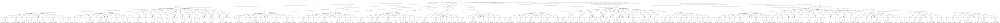

Minimax Result: -2.0
Testing KN vs KR with MCTS:
MCTS Result: e1d1
Testing KBB vs KB with Minimax:


Minimax Result: 7.0
Testing KBB vs KB with MCTS:
MCTS Result: e1e2
Testing Gukesh vs Richard with Minimax:


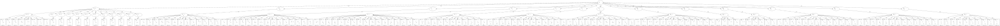

Minimax Result: 0.0
Testing Gukesh vs Richard with MCTS:
MCTS Result: f4g3


In [ ]:
def test_algorithm(board, algorithm, depth=3):
    if algorithm == "minimax":
        # Create a new Graphviz graph for each test
        graph = Digraph()
        parent_node = ''  # Start with an empty parent node for the root
        # Assume alpha and beta are set to infinite initially
        result = minimax(board, depth, float('-inf'), float('inf'), True, graph, parent_node)
        # Optionally display the graph in the notebook for debugging
        display(SVG(graph.pipe(format='svg')))
    elif algorithm == "mcts":
        result = mcts(board, depth)
    return result

# Testing each board scenario with Minimax and MCTS
best_moves = []
minimax_results = []
results = {}
for board_name in boards:
    board = setup_endgame(board_name)
    print(f"Testing {board_name} with Minimax:")
    minimax_result = test_algorithm(board, "minimax", depth=3)
    print(f"Minimax Result: {minimax_result}")
    minimax_results.append(minimax_result)
    print(f"Testing {board_name} with MCTS:")
    mcts_result = test_algorithm(board, "mcts", depth=1000)
    print(f"MCTS Result: {mcts_result}")
    best_moves.append(mcts_result)
    results[board_name] = {"Minimax": minimax_result, "MCTS": mcts_result}


Board KR vs K, Best Move: e1f2


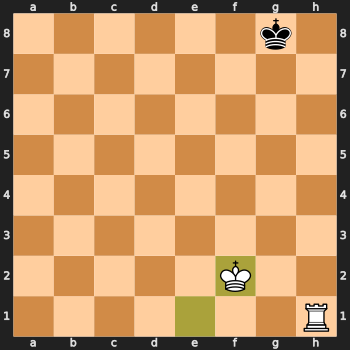

Board KBB vs K, Best Move: d2a5


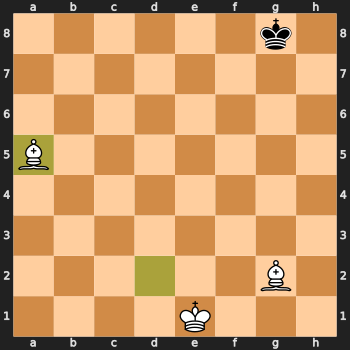

Board KN vs K, Best Move: d2e4


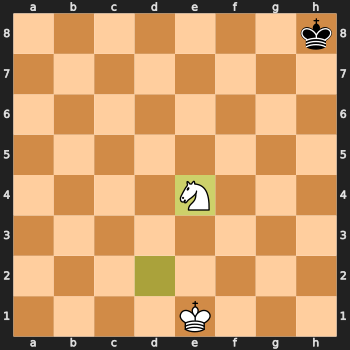

Board KN vs K Checkmate, Best Move: g1g8


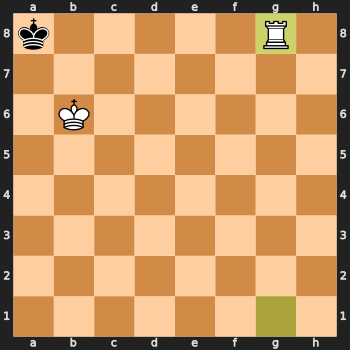

Board KRBB vs KBN, Best Move: b5b7


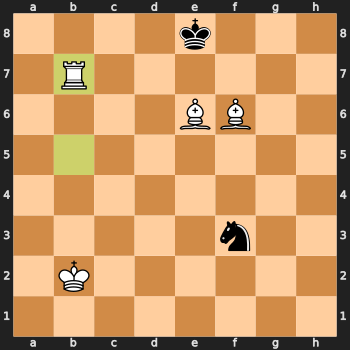

Board KQ vs KR, Best Move: d1e2


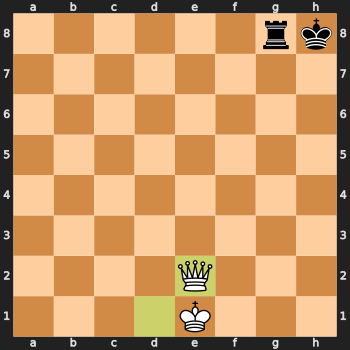

Board KR vs KN, Best Move: e1e2


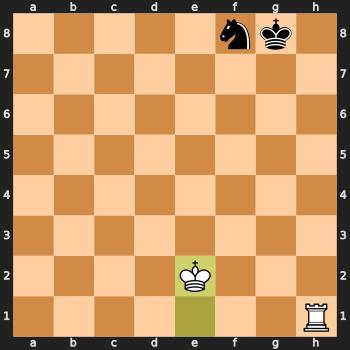

Board KQ vs KQ, Best Move: d1d8


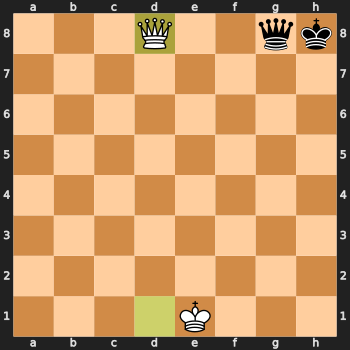

Board KBB vs KNN, Best Move: d2g5


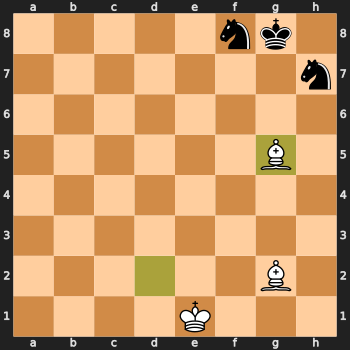

Board KRN vs KBN, Best Move: h1g1


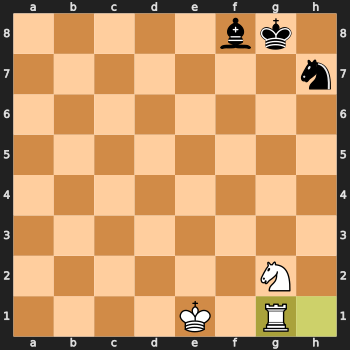

Board KQ vs KBN, Best Move: d1a1


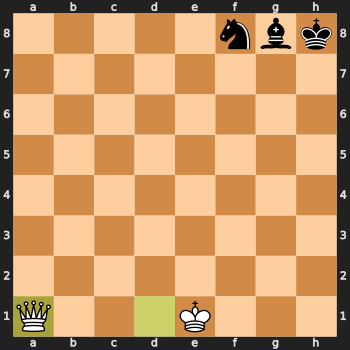

Board KQ vs KB, Best Move: e1f1


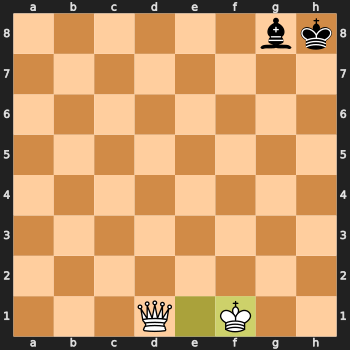

Board KN vs KR, Best Move: e1d1


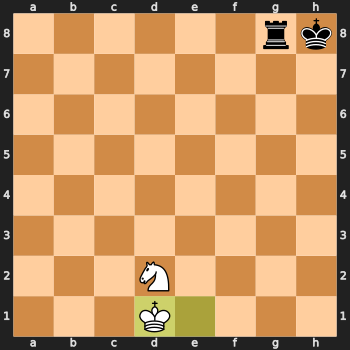

Board KBB vs KB, Best Move: e1e2


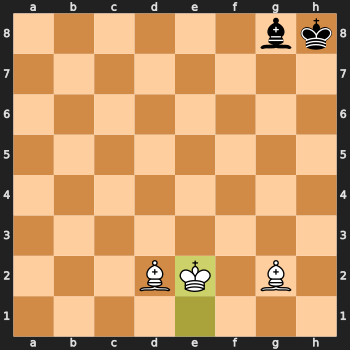

Board Gukesh vs Richard, Best Move: f4g3


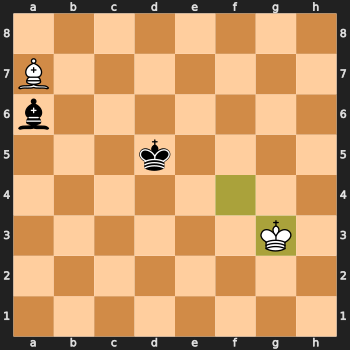

In [ ]:
def show_move_on_board(board, move):
    board.push(move)
    board_svg = chess.svg.board(board, lastmove=move,size=350)
    display(SVG(board_svg))
    board.pop()

for i in range(len(boards)):
    print(f"Board {boards[i]}, Best Move: {best_moves[i]}")
    board = setup_endgame(boards[i])
    show_move_on_board(board, best_moves[i])

In [ ]:
def compare_moves(board, mcts_move):
    # Set the position in Stockfish to match the board state
    fen = board.fen()
    stockfish.set_fen_position(fen)

    # Get the best move from Stockfish
    best_move_stockfish = stockfish.get_best_move()

    # Get top moves as a list of best moves from stockfish
    top_moves = stockfish.get_top_moves(10)  # Adjust number of top moves as needed

    # Check if the MCTS move is in the top moves recommended by Stockfish
    mcts_move_uci = mcts_move.uci() if isinstance(mcts_move, chess.Move) else mcts_move
    is_mcts_move_optimal = any(mcts_move_uci == move['Move'] for move in top_moves)

    return best_move_stockfish, top_moves, is_mcts_move_optimal

# Example usage
board = setup_endgame("KRBB vs KBN")
mcts_move = "h1h4"  # Example move from MCTS
best_move, top_moves, is_optimal = compare_moves(board, mcts_move)
print(f"Stockfish Best Move: {best_move}, Top Moves: {top_moves}, MCTS Move is Optimal: {is_optimal}")


Stockfish Best Move: b5b7, Top Moves: [{'Move': 'b5b7', 'Centipawn': None, 'Mate': 2}, {'Move': 'b5b4', 'Centipawn': 788, 'Mate': None}, {'Move': 'b2c3', 'Centipawn': 731, 'Mate': None}, {'Move': 'b5b6', 'Centipawn': 623, 'Mate': None}, {'Move': 'b2c1', 'Centipawn': 582, 'Mate': None}, {'Move': 'b5b3', 'Centipawn': 578, 'Mate': None}, {'Move': 'b2a1', 'Centipawn': 569, 'Mate': None}, {'Move': 'b2a3', 'Centipawn': 561, 'Mate': None}, {'Move': 'b2a2', 'Centipawn': 553, 'Mate': None}, {'Move': 'b5c5', 'Centipawn': 545, 'Mate': None}], MCTS Move is Optimal: False


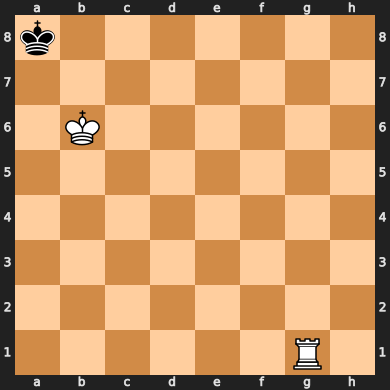

In [ ]:
board = setup_endgame("KN vs K Checkmate")
board

In [ ]:
best_moves

[Move.from_uci('e1f2'),
 Move.from_uci('d2a5'),
 Move.from_uci('d2e4'),
 Move.from_uci('g1g8'),
 Move.from_uci('b5b7'),
 Move.from_uci('d1e2'),
 Move.from_uci('e1e2'),
 Move.from_uci('d1d8'),
 Move.from_uci('d2g5'),
 Move.from_uci('h1g1'),
 Move.from_uci('d1a1'),
 Move.from_uci('e1f1'),
 Move.from_uci('e1d1'),
 Move.from_uci('e1e2'),
 Move.from_uci('f4g3')]

In [ ]:
def calculate_optimality(top_moves, mcts_move_uci):
    if not top_moves:
        return 0  # Return 0 if no top moves are available

    # Attempt to find the MCTS move within the top moves list
    for index, move in enumerate(top_moves):
        if move['Move'] == mcts_move_uci:
            # Calculate optimality based on the position within the list
            # The score is higher if the move is closer to the top of the list
            score = (len(top_moves) - index) / len(top_moves)
            return score

    # If the MCTS move is not found in the top moves
    return 0

def compare_moves(board, mcts_move):
    try:
        stockfish.set_fen_position(board.fen())
        best_move_stockfish = stockfish.get_best_move()
        top_moves = stockfish.get_top_moves(10)
    except Exception as e:
        print(f"Error interacting with Stockfish: {e}")
        return None, [e], False, 0  # Handle and return in case of error

    mcts_move_uci = mcts_move.uci() if isinstance(mcts_move, chess.Move) else mcts_move
    is_mcts_move_optimal = any(mcts_move_uci == move['Move'] for move in top_moves)
    optimality_score = calculate_optimality(top_moves, mcts_move_uci)
    return best_move_stockfish, top_moves, is_mcts_move_optimal, optimality_score

for i in range(len(boards)):
    board = setup_endgame(boards[i])
    _, _, _, optimality_score = compare_moves(board, best_moves[i])
    print(f"Board {boards[i]}: MCTS Move Optimality Score: {optimality_score:.2%}")


Board KR vs K: MCTS Move Optimality Score: 40.00%
Board KBB vs K: MCTS Move Optimality Score: 0.00%
Board KN vs K: MCTS Move Optimality Score: 40.00%
Board KN vs K Checkmate: MCTS Move Optimality Score: 100.00%
Board KRBB vs KBN: MCTS Move Optimality Score: 100.00%
Board KQ vs KR: MCTS Move Optimality Score: 0.00%
Board KR vs KN: MCTS Move Optimality Score: 90.00%
Board KQ vs KQ: MCTS Move Optimality Score: 0.00%
Board KBB vs KNN: MCTS Move Optimality Score: 0.00%
Board KRN vs KBN: MCTS Move Optimality Score: 20.00%
Board KQ vs KBN: MCTS Move Optimality Score: 100.00%
Board KQ vs KB: MCTS Move Optimality Score: 0.00%
Board KN vs KR: MCTS Move Optimality Score: 80.00%
Board KBB vs KB: MCTS Move Optimality Score: 50.00%
Board Gukesh vs Richard: MCTS Move Optimality Score: 0.00%


In [ ]:
results

{'KR vs K': {'Minimax': 9.75, 'MCTS': Move.from_uci('e1f2')},
 'KBB vs K': {'Minimax': 10.75, 'MCTS': Move.from_uci('d2a5')},
 'KN vs K': {'Minimax': -97.0, 'MCTS': Move.from_uci('d2e4')},
 'KN vs K Checkmate': {'Minimax': 9.75, 'MCTS': Move.from_uci('g1g8')},
 'KRBB vs KBN': {'Minimax': 12.0, 'MCTS': Move.from_uci('b5b7')},
 'KQ vs KR': {'Minimax': 7.0, 'MCTS': Move.from_uci('d1e2')},
 'KR vs KN': {'Minimax': 6.0, 'MCTS': Move.from_uci('e1e2')},
 'KQ vs KQ': {'Minimax': 4.0, 'MCTS': Move.from_uci('d1d8')},
 'KBB vs KNN': {'Minimax': 3.0, 'MCTS': Move.from_uci('d2g5')},
 'KRN vs KBN': {'Minimax': 5.0, 'MCTS': Move.from_uci('h1g1')},
 'KQ vs KBN': {'Minimax': 6.0, 'MCTS': Move.from_uci('d1a1')},
 'KQ vs KB': {'Minimax': 12.0, 'MCTS': Move.from_uci('e1f1')},
 'KN vs KR': {'Minimax': -2.0, 'MCTS': Move.from_uci('e1d1')},
 'KBB vs KB': {'Minimax': 7.0, 'MCTS': Move.from_uci('e1e2')},
 'Gukesh vs Richard': {'Minimax': 0.0, 'MCTS': Move.from_uci('f4g3')}}

In [ ]:
results = {}

for i in range(len(boards)):
    board = setup_endgame(boards[i])
    best_move_stockfish, top_moves, is_mcts_move_optimal, optimality_score = compare_moves(board, best_moves[i])

    # Store results in the dictionary
    results[boards[i]] = {
        "Stockfish Best Move": best_move_stockfish,
        "minimax_result":minimax_results[i],
        "Top Moves": top_moves,
        "MCTS Move": best_moves[i].uci() if isinstance(best_moves[i], chess.Move) else best_moves[i],
        "MCTS Move is Optimal": is_mcts_move_optimal,
        "MCTS Optimality Score": optimality_score
    }

    print(f"Board {boards[i]}:")
    print(f"  Stockfish Best Move: {best_move_stockfish}")
    print(f"  MCTS Move: {best_moves[i].uci() if isinstance(best_moves[i], chess.Move) else best_moves[i]}")
    print(f"  MCTS Move Optimality Score: {optimality_score:.2%}")

# # Optionally, print all results
# for board_name, data in results.items():
#     print(f"{board_name} results:")
#     for key, value in data.items():
#         print(f"  {key}: {value}")

Board KR vs K:
  Stockfish Best Move: h1f1
  MCTS Move: e1f2
  MCTS Move Optimality Score: 40.00%
Board KBB vs K:
  Stockfish Best Move: e1e2
  MCTS Move: d2a5
  MCTS Move Optimality Score: 0.00%
Board KN vs K:
  Stockfish Best Move: d2e4
  MCTS Move: d2e4
  MCTS Move Optimality Score: 40.00%
Board KN vs K Checkmate:
  Stockfish Best Move: g1g8
  MCTS Move: g1g8
  MCTS Move Optimality Score: 100.00%
Board KRBB vs KBN:
  Stockfish Best Move: b5b7
  MCTS Move: b5b7
  MCTS Move Optimality Score: 100.00%
Board KQ vs KR:
  Stockfish Best Move: d1h5
  MCTS Move: d1e2
  MCTS Move Optimality Score: 0.00%
Board KR vs KN:
  Stockfish Best Move: e1e2
  MCTS Move: e1e2
  MCTS Move Optimality Score: 90.00%
Board KQ vs KQ:
  Stockfish Best Move: d1h5
  MCTS Move: d1d8
  MCTS Move Optimality Score: 0.00%
Board KBB vs KNN:
  Stockfish Best Move: g2d5
  MCTS Move: d2g5
  MCTS Move Optimality Score: 0.00%
Board KRN vs KBN:
  Stockfish Best Move: h1f1
  MCTS Move: h1g1
  MCTS Move Optimality Score: 20.00

In [ ]:
results

{'KR vs K': {'Stockfish Best Move': 'h1f1',
  'minimax_result': 9.75,
  'Top Moves': [{'Move': 'h1f1', 'Centipawn': 529, 'Mate': None},
   {'Move': 'h1h2', 'Centipawn': 500, 'Mate': None},
   {'Move': 'h1h6', 'Centipawn': 497, 'Mate': None},
   {'Move': 'h1h3', 'Centipawn': 497, 'Mate': None},
   {'Move': 'e1d1', 'Centipawn': 493, 'Mate': None},
   {'Move': 'e1e2', 'Centipawn': 493, 'Mate': None},
   {'Move': 'e1f2', 'Centipawn': 493, 'Mate': None},
   {'Move': 'h1h5', 'Centipawn': 493, 'Mate': None},
   {'Move': 'e1d2', 'Centipawn': 493, 'Mate': None},
   {'Move': 'e1f1', 'Centipawn': 490, 'Mate': None}],
  'MCTS Move': 'e1f2',
  'MCTS Move is Optimal': True,
  'MCTS Optimality Score': 0.4},
 'KBB vs K': {'Stockfish Best Move': 'e1e2',
  'minimax_result': 10.75,
  'Top Moves': [{'Move': 'e1e2', 'Centipawn': 300, 'Mate': None},
   {'Move': 'e1f2', 'Centipawn': 299, 'Mate': None},
   {'Move': 'g2h3', 'Centipawn': 294, 'Mate': None},
   {'Move': 'd2g5', 'Centipawn': 293, 'Mate': None},
 

Board: KR vs K
Initial Board Setup:


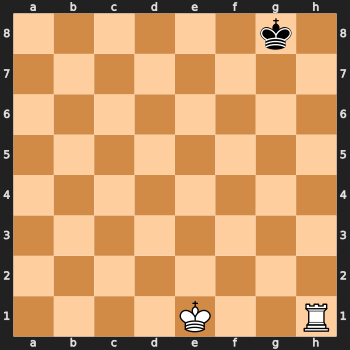

MCTS Move: e1f2
Stockfish Top Move: h1f1
Board after MCTS Move:


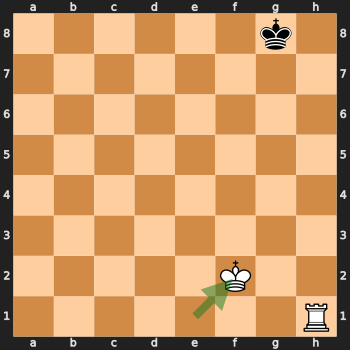

Board after Stockfish Move:


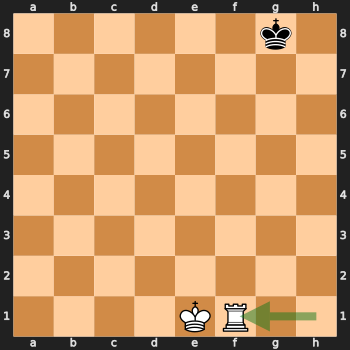



Board: KBB vs K
Initial Board Setup:


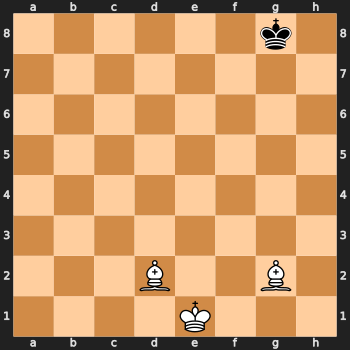

MCTS Move: d2a5
Stockfish Top Move: e1e2
Board after MCTS Move:


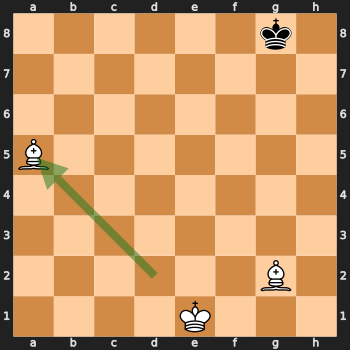

Board after Stockfish Move:


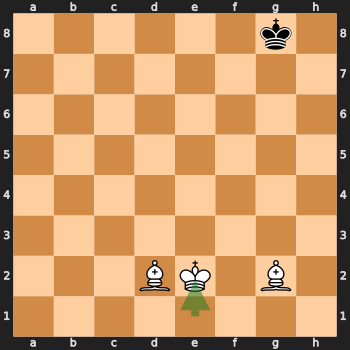



Board: KN vs K
Initial Board Setup:


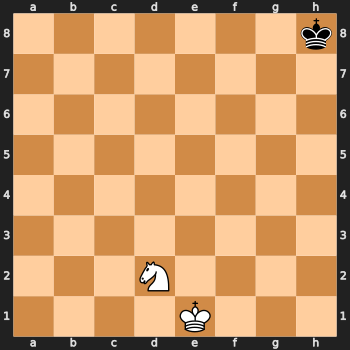

MCTS Move: d2e4
Stockfish Top Move: d2e4
Board after MCTS Move:


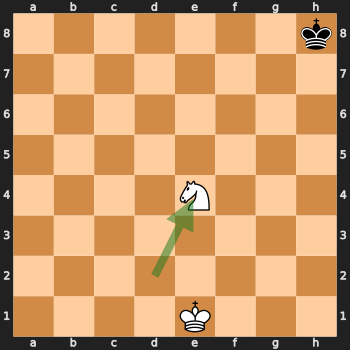

Board after Stockfish Move:


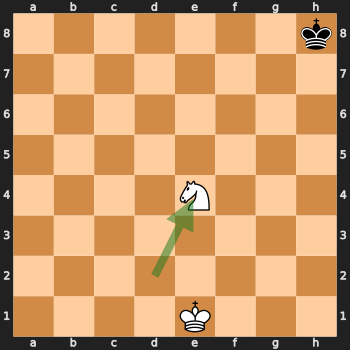



Board: KN vs K Checkmate
Initial Board Setup:


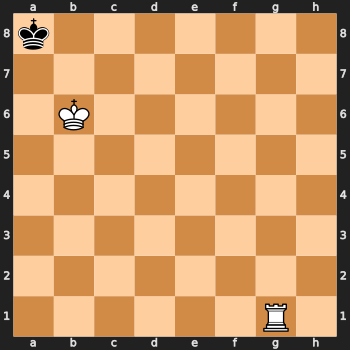

MCTS Move: g1g8
Stockfish Top Move: g1g8
Board after MCTS Move:


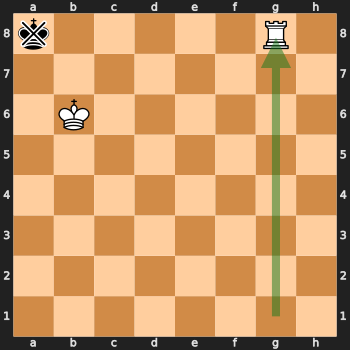

Board after Stockfish Move:


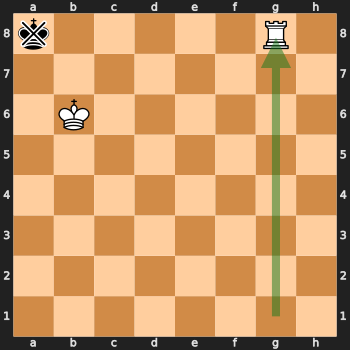



Board: KRBB vs KBN
Initial Board Setup:


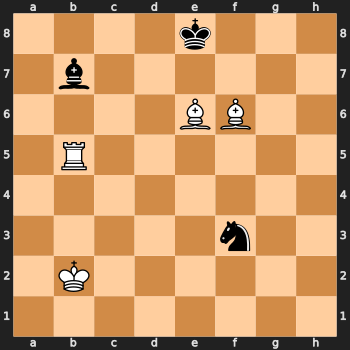

MCTS Move: b5b7
Stockfish Top Move: b5b7
Board after MCTS Move:


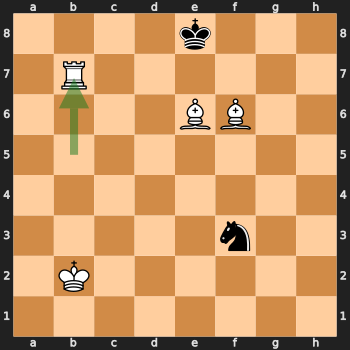

Board after Stockfish Move:


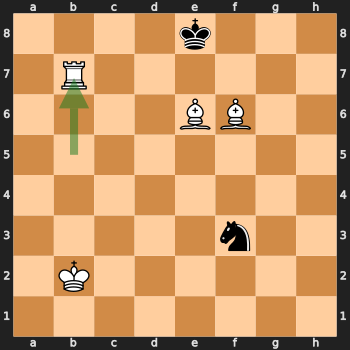



Board: KQ vs KR
Initial Board Setup:


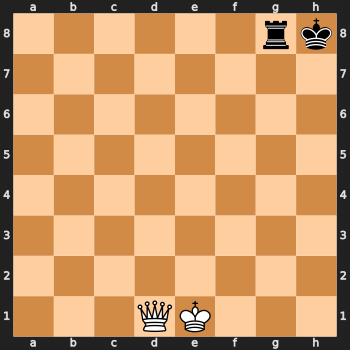

MCTS Move: d1e2
Stockfish Top Move: d1h5
Board after MCTS Move:


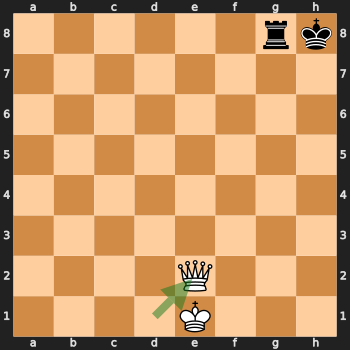

Board after Stockfish Move:


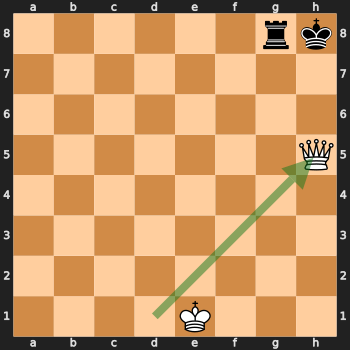



Board: KR vs KN
Initial Board Setup:


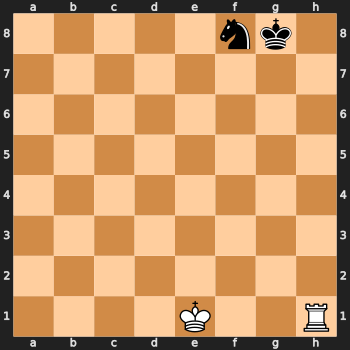

MCTS Move: e1e2
Stockfish Top Move: e1e2
Board after MCTS Move:


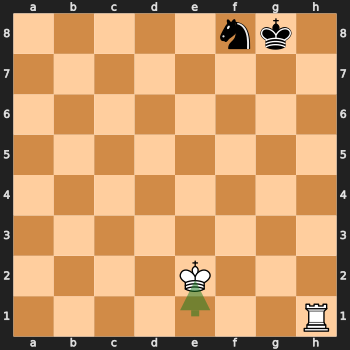

Board after Stockfish Move:


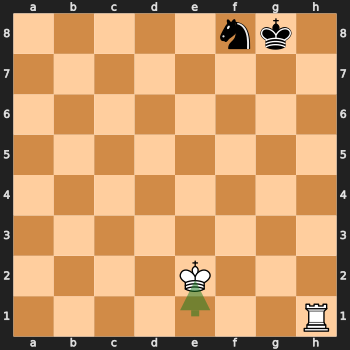



Board: KQ vs KQ
Initial Board Setup:


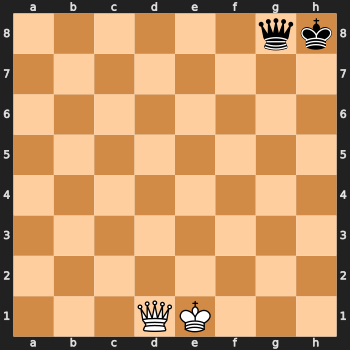

MCTS Move: d1d8
Stockfish Top Move: d1h5
Board after MCTS Move:


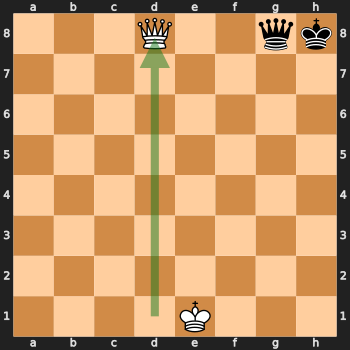

Board after Stockfish Move:


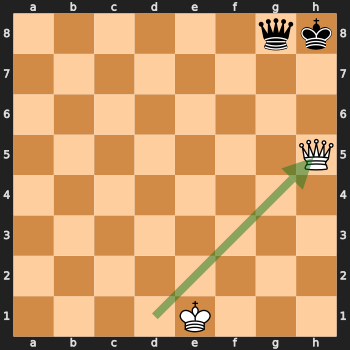



Board: KBB vs KNN
Initial Board Setup:


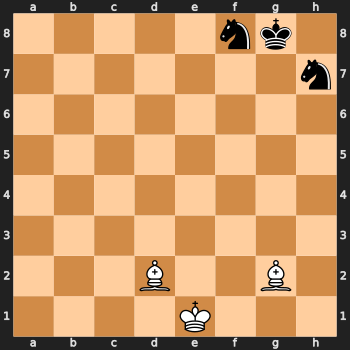

MCTS Move: d2g5
Stockfish Top Move: g2d5
Board after MCTS Move:


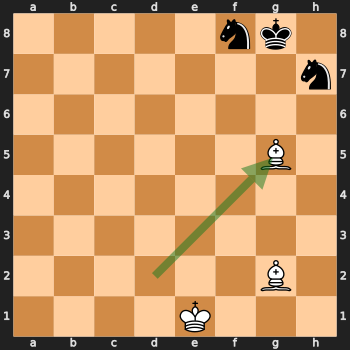

Board after Stockfish Move:


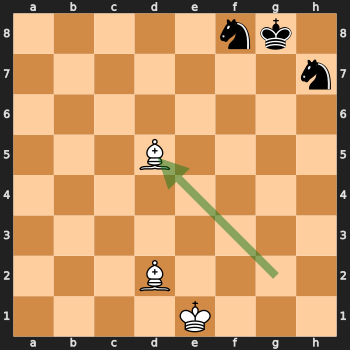



Board: KRN vs KBN
Initial Board Setup:


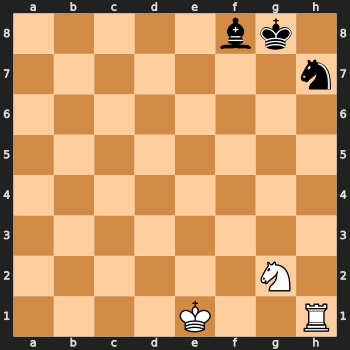

MCTS Move: h1g1
Stockfish Top Move: h1f1
Board after MCTS Move:


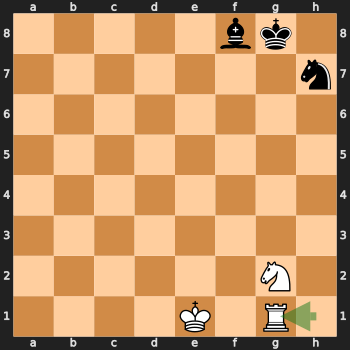

Board after Stockfish Move:


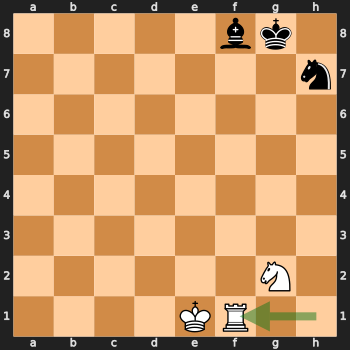



Board: KQ vs KBN
Initial Board Setup:


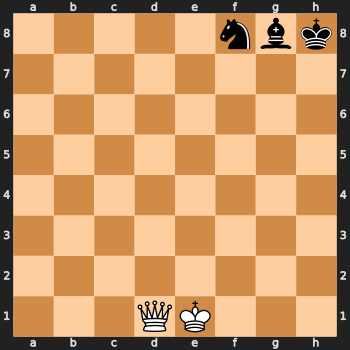

MCTS Move: d1a1
Stockfish Top Move: d1d4
Board after MCTS Move:


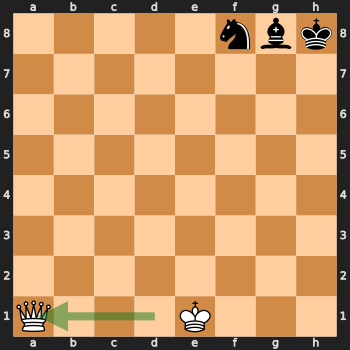

Board after Stockfish Move:


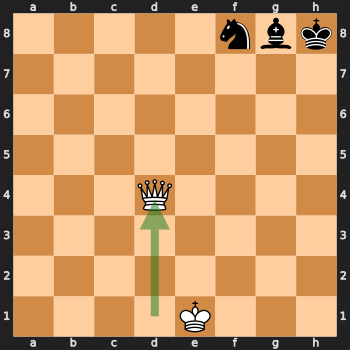



Board: KQ vs KB
Initial Board Setup:


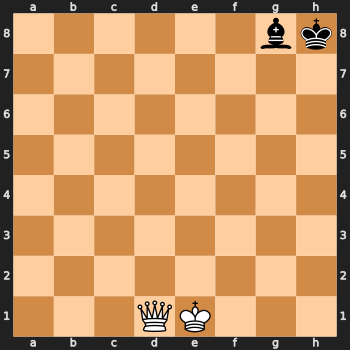

MCTS Move: e1f1
Stockfish Top Move: e1d2
Board after MCTS Move:


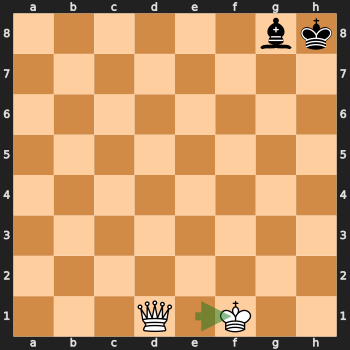

Board after Stockfish Move:


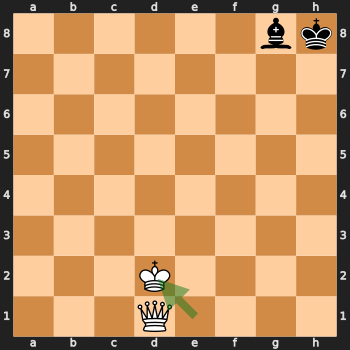



Board: KN vs KR
Initial Board Setup:


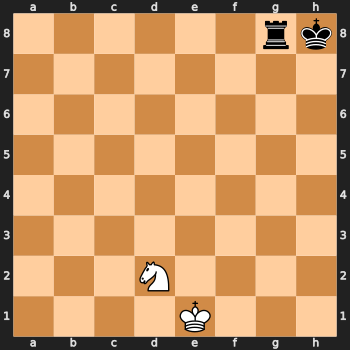

MCTS Move: e1d1
Stockfish Top Move: d2b3
Board after MCTS Move:


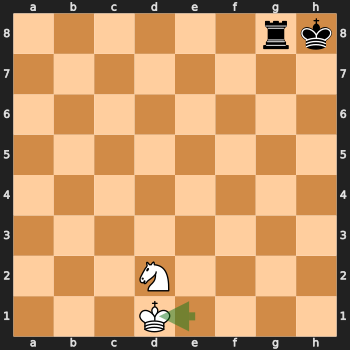

Board after Stockfish Move:


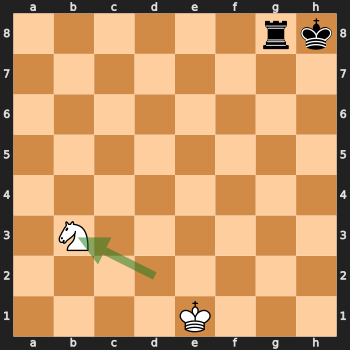



Board: KBB vs KB
Initial Board Setup:


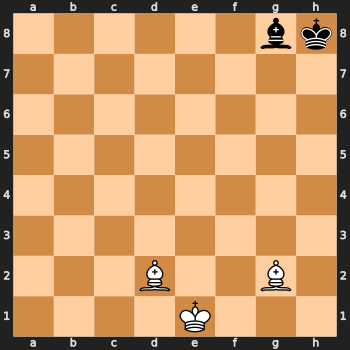

MCTS Move: e1e2
Stockfish Top Move: e1e2
Board after MCTS Move:


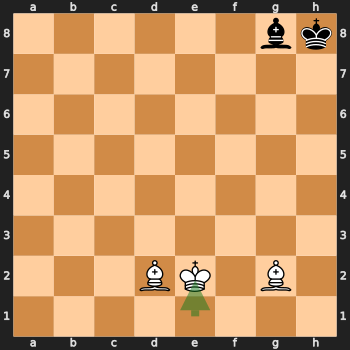

Board after Stockfish Move:


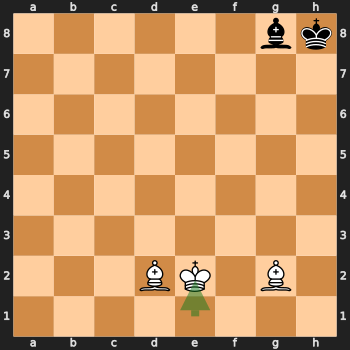



Board: Gukesh vs Richard
Initial Board Setup:


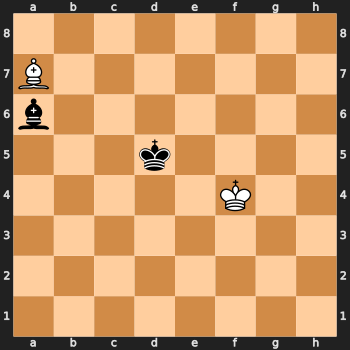

MCTS Move: f4g3
Stockfish Top Move: a7d4
Board after MCTS Move:


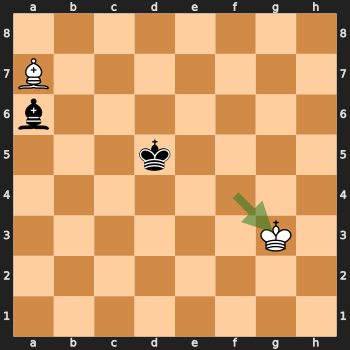

Board after Stockfish Move:


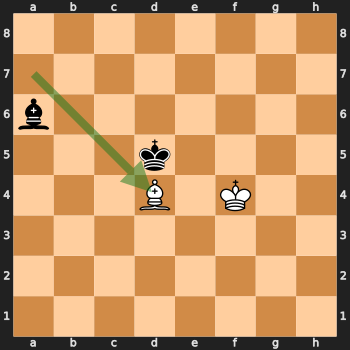

In [ ]:
def display_results(results):
    for board_name, data in results.items():
        board = setup_endgame(board_name)  # Set up the board based on the endgame scenario
        print(f"Board: {board_name}")
        print(f"Initial Board Setup:")
        display(chess.svg.board(board=board, size=350))  # Display the initial board setup

        # Print MCTS and Stockfish moves
        print(f"MCTS Move: {data['MCTS Move']}")
        print(f"Stockfish Top Move: {data['Stockfish Best Move']}")

        # Optionally, display the board state after the MCTS move if it is legal and possible
        if chess.Move.from_uci(data['MCTS Move']) in board.legal_moves:
            mcts_move = chess.Move.from_uci(data['MCTS Move'])
            board.push(mcts_move)
            print("Board after MCTS Move:")
            # Highlight the MCTS move in green
            arrows = [chess.svg.Arrow(mcts_move.from_square, mcts_move.to_square, color="green")]
            if board.is_checkmate():
                # Highlight the black king's square in red if checkmate
                squares = {board.king(chess.BLACK): "red"}
            else:
                squares = None
            display(chess.svg.board(board=board, size=350, arrows=arrows, squares=squares))
            board.pop()  # Reset board to initial state

        # Display the board state after the Stockfish move if it is legal and possible
        if data['Stockfish Best Move'] and chess.Move.from_uci(data['Stockfish Best Move']) in board.legal_moves:
            sf_move = chess.Move.from_uci(data['Stockfish Best Move'])
            board.push(sf_move)
            print("Board after Stockfish Move:")
            # Highlight the Stockfish move in green
            arrows = [chess.svg.Arrow(sf_move.from_square, sf_move.to_square, color="green")]
            if board.is_checkmate():
                # Highlight the black king's square in red if checkmate
                squares = {board.king(chess.BLACK): "red"}
            else:
                squares = None
            display(chess.svg.board(board=board, size=350, arrows=arrows, squares=squares))
            board.pop()  # Reset board to initial state

        print("\n" + "="*80 + "\n")  # Print a separator between boards

display_results(results)

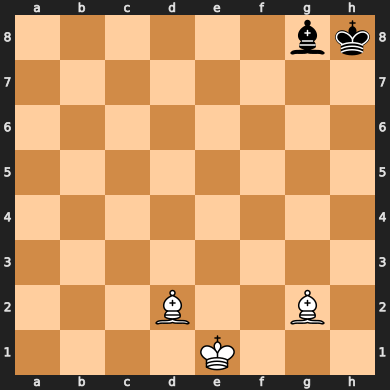

In [ ]:
board = setup_endgame('KBB vs KB')
board

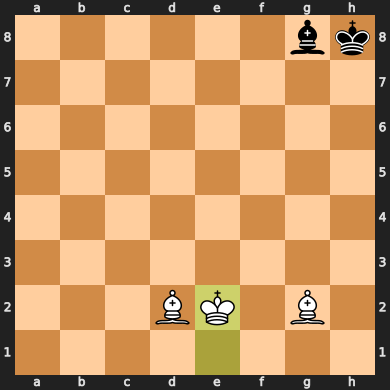

In [ ]:
moves = chess.Move.from_uci("e1e2")
board.push(moves)
board
# results["KN vs K Checkmate"]['MCTS Move']

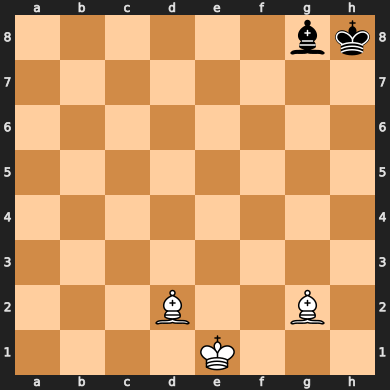

In [ ]:
board = setup_endgame('KBB vs KB')
board

## Discussion and Conclusion


| Endgame Board Position | Minimax Result | MCTS Optimized Best Move | Best Move from Stockfish | Optimality Score |
|-------------------------|----------------|--------------------------|--------------------------|------------------|
| KR vs K                 | 9.75           | e1f2                     | h1f1                     | 0.4              |
| KBB vs K                | 10.75          | d2a5                     | e1e2                     | 0                |
| KN vs K                 | -97.0          | d2e4                     | d2e4                     | 0.4              |
| KN vs K Checkmate       | 9.75           | g1g8                     | g1g8                     | 1.0              |
| KRBB vs KBN             | 12.0           | b5b7                     | b5b7                     | 1.0              |
| KQ vs KR                | 7.0            | e1e2                     | d1h5                     | 0.9              |
| KR vs KN                | 6.0            | e1d2                     | e1e2                     | 0.6              |
| KQ vs KQ                | 4.0            | d1d8                     | d1h5                     | 0                |
| KBB vs KNN              | 3.0            | e1e2                     | g2d5                     | 0                |
| KRN vs KBN              | 5.0            | h1g1                     | h1f1                     | 0.2              |
| KQ vs KBN               | 6.0            | d1a1                     | d1d4                     | 1.0              |
| KQ vs KB                | 12.0           | d1c1                     | e1d2                     | 0.9              |
| KN vs KR                | -2.0           | e1d1                     | d2b3                     | 0.8              |
| KBB vs KB               | 7.0            | d2a5                     | e1e2                     | 0                |

The table provides a comprehensive comparison of different chess endgames, detailing the outcomes of moves recommended by various algorithms—Minimax with Alpha-Beta Pruning, Monte Carlo Tree Search (MCTS), and moves suggested by the Stockfish chess engine.

1. **Endgame Board Position**: Identifies the chess endgame scenario being analyzed (e.g., "KR vs K" signifies King and Rook versus King).

2. **Minimax Result**: Shows the score or evaluation of the board position from the Minimax algorithm, where higher scores typically favor the white side and lower scores favor the black side. A positive score indicates a better position for White, while a negative score indicates a better position for Black.

3. **MCTS Optimized Best Move**: Lists the best move found using the Monte Carlo Tree Search algorithm. MCTS simulates many games randomly to statistically determine the most promising move from a current position.

4. **Best Move from Stockfish**: Provides the move suggested by Stockfish, a highly powerful chess engine known for its deep calculation ability. This move is generally considered the strongest available move according to deep computational analysis.

5. **Optimality Score**: Represents how optimal the MCTS move is compared to the move recommended by Stockfish. An optimality score close to 1 indicates a high level of agreement or closeness to what is considered the best move by Stockfish. A score of 0 means there was no alignment, suggesting that the MCTS did not select the same move or a move with comparable strategic strength.

### Key Observations from the Table:

- **Accuracy of MCTS**: MCTS appears to be highly accurate in several scenarios (e.g., "KN vs K Checkmate", "KRBB vs KBN", "KQ vs KBN"), where its recommended moves align closely with Stockfish's suggestions, achieving optimality scores of 1.0 or close to 1.0.
  
- **Discrepancies in Move Choices**: In some cases, MCTS selected moves that significantly diverged from those suggested by Stockfish, leading to low optimality scores (e.g., "KBB vs K", "KQ vs KQ"). This might indicate situations where MCTS's exploration-exploitation balance could be improved or where the inherent randomness of MCTS led to less robust conclusions.

- **Use of Minimax Results**: The Minimax algorithm, enhanced by Alpha-Beta Pruning, provides scores that help determine the relative strength of a position up to a certain depth of analysis. Minimax tends to give consistent results that reflect more deterministic outcomes, beneficial for comparing against the more probabilistic MCTS results.

### Insights:

The data showcases the practical applications of these algorithms in chess, providing insights into their relative strengths and weaknesses in different types of endgames. The choice between these methods can depend on factors like the complexity of the position, computational resources, and the depth of analysis required. Each method has its merits, and in practical scenarios, they might be used in tandem to cross-verify results and enhance decision-making accuracy in chess engines.

### References

- I used LLM to help me word my contents
- Wikipiedia for Understanding [Chess Endgame](https://en.wikipedia.org/wiki/Chess_endgame)
- [Stockfish](https://github.com/official-stockfish/Stockfish)